In [1]:
using StatsPlots
using LinearAlgebra
using Random
using Statistics
using Distributions
using Plots

In [70]:
function MHRW(energia,np,p0,δ=0.5,iterations=10000)
    
    
    #Muestras del algorimo
    samples = zeros(np,iterations)
    #Punto de partida
    ## Se escoge el punto inicial obtenido de invertir el operador A
    samples[:,1] = p0
    
    #Probabilidades
    probabilities = zeros(iterations)
    probabilities[1] = energia(samples[:,1])
    
    #Tasa de aceptación
    rateAlpha = 0
    
    # Algoritmo Metrópolis-Hastings
    for i in 1:iterations-1
        
        #Estado actual
        Xᵢ = samples[:,i]
        #Estado propuesto
        X₊ = rand(MvNormal(Xᵢ,δ*I))
        
        #π(Estado actual → Estado propuesto)
        pXᵢX₊ = energia(X₊) * pdf(MvNormal(Xᵢ,δ*I),X₊)
        #π(Estado propuesto → Estado actual)
        pX₊Xᵢ = energia(Xᵢ) * pdf(MvNormal(X₊,δ*I),Xᵢ)
        #Tasa de aceptacion α
        alpha = min(1, pXᵢX₊/pX₊Xᵢ)
    
        #Aceptación o rechazo del estado propuesto
        u = rand()    
        if u < alpha 				#Aceptación
            samples[:,i+1] = X₊
            probabilities[i+1] = energia(X₊)
            rateAlpha += 1
        else 						#Rechazo
            samples[:,i+1] = Xᵢ
            probabilities[i+1] = energia(Xᵢ)
        end
    end
    rateAlpha /= (iterations-1)
    MAP = samples[:,findmax(probabilities)[2]]
    CM = [mean(row) for row in eachrow(samples)]
    return samples, probabilities, MAP, CM, rateAlpha
end

MHRW (generic function with 3 methods)

In [203]:
function MCIntegration(s)
    n = length(s)
    integral = zeros(n)
    convergence = zeros(n-1)
    for i in 1:n
        integral[i] = mean(s[1:i])
    end
    for j in 2:n
        convergence[j-1] = abs(integral[j]-integral[j-1])
    end

    rate = [ones(n-1) log.(1:n-1) ] \ log.(convergence)
    
    return convergence, rate
end

MCIntegration (generic function with 1 method)

# Ejemplo 0

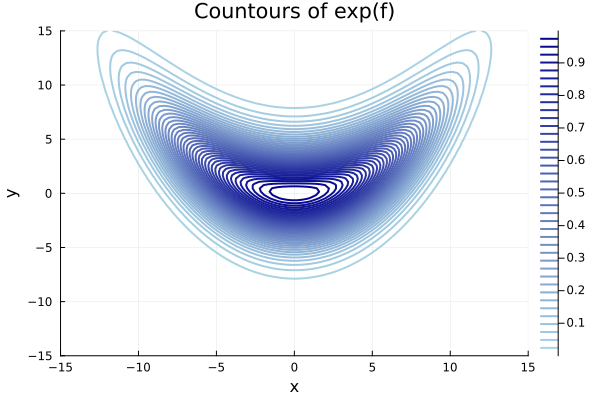

In [231]:
function energia0(p)
    x = p[1]
    y = p[2]
    a = ((1/10)*x^2-y)^2+(1/5)*(x^2+y^2)
    return exp(-a/20) 
end
ran = range(-15, 15, length=100)
Z = [energia0((i, j)) for j in ran, i in ran]

contour(ran, ran, Z, levels=40, linewidth=2, color=:blues,xlim=(-15,15),ylim=(-15,15),title="Countours of exp(f)",xlabel="x", ylabel="y")
#savefig("4_MHRW_contours.png")

# Usando MHRW

In [165]:
samples0, probabilities0, MAP0, CM0, rateAlpha0 = MHRW(energia0,2,[-15.0,-15.0],0.1,10000)

([-15.0 -14.715944089780285 … -2.7271590466555167 -2.6933871187157243; -15.0 -14.65154859792161 … 1.0550095472799053 0.6415976639444094], [3.2310529305500156e-33, 3.1782287194941724e-31, 3.1782287194941724e-31, 2.7906965921552355e-31, 4.20735378433724e-29, 4.20735378433724e-29, 9.548927876332958e-28, 2.960946262365959e-26, 2.960946262365959e-26, 2.960946262365959e-26  …  0.9474282728879269, 0.9035349112555412, 0.8789124853734418, 0.8804782134174469, 0.8742999441055174, 0.8793913032512131, 0.8940274495448308, 0.9064304813302179, 0.9136124035015981, 0.9258794475777908], [-0.040208665834660706, 0.0002313391507761109], [-0.6819951145192901, -0.415574985054509], 0.9427942794279428)

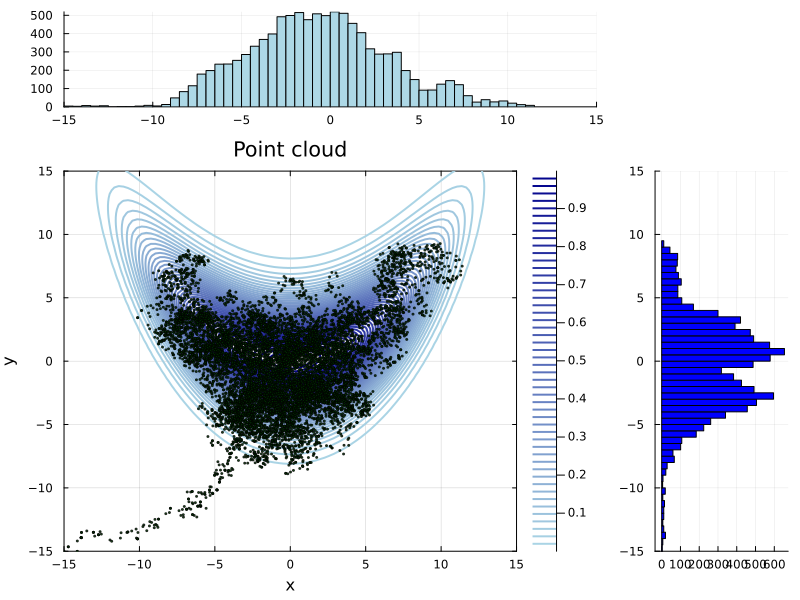

In [225]:
xhist = samples0[1, :]
yhist = samples0[2, :]
sxy = contour(ran, ran, Z, levels=50, linewidth=2, color=:blues,xlim=(-15,15),ylim=(-15,15))
sxy = scatter!(xhist, yhist, markersize=1, title="Point cloud", color="green", alpha=0.8,
    xlabel="x", ylabel="y", border=:box,xlim=(-15,15),ylim=(-15,15))
hx = histogram(xhist,color="lightblue",xlim=(-15,15))
hy = histogram(yhist, orientation=:horizontal,ylim=(-15,15),color="blue")
p0 = Plots.Plot()
cuadricula = grid(2,2, heights=(0.2,0.8), widths=(0.8,0.2))
plot(hx, p0, sxy, hy, legend=:none, layout=cuadricula,size=(800,600))
#savefig("4_MHRW_pointcloud.png")

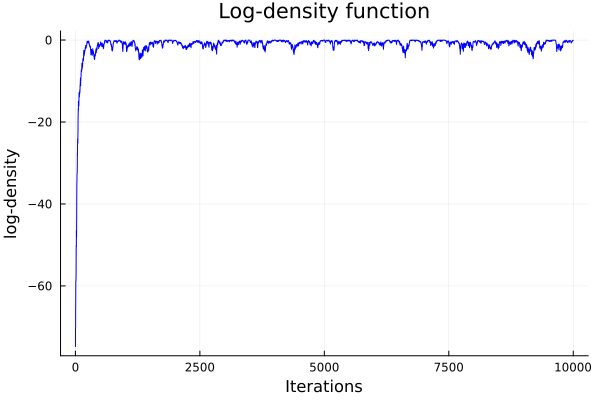

In [224]:
plot(log.(probabilities0[1:end]),label="", title="Log-density function", color="blue",
xlabel="Iterations",ylabel="log-density")
#savefig("4_MHRW_logdensity.png")

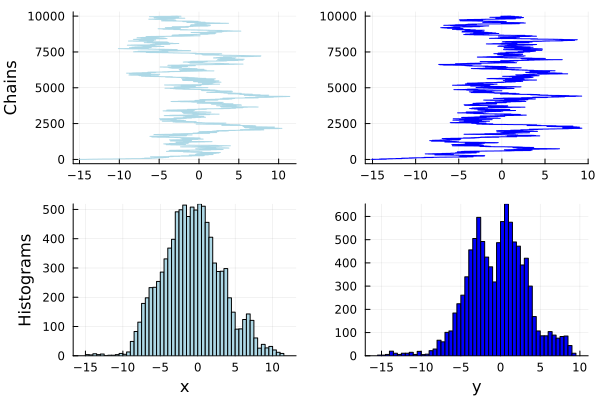

In [227]:
p11 = plot(samples0[1, :],1:10000,color="lightblue",label="",ylabel="Chains")
p12 = plot(samples0[2, :],1:10000,color="blue",label="")
p21 = histogram(samples0[1, :],color="lightblue",label="",xlabel="x",ylabel="Histograms")
p22 = histogram(samples0[2, :],color="blue",label="",xlabel="y")
plot(p11,p12,p21,p22,layout=(2,2))
#savefig("4_MHRW_histogramsandchains.png")

In [209]:
string(4)

"4"

In [213]:
MCIntegration(samples0[1, :])[2]

2-element Vector{Float64}:
  0.4747038228958918
 -0.9680259017443692

In [214]:
MCIntegration(samples0[2, :])[2]

2-element Vector{Float64}:
  1.0325560562945457
 -1.044974133264012

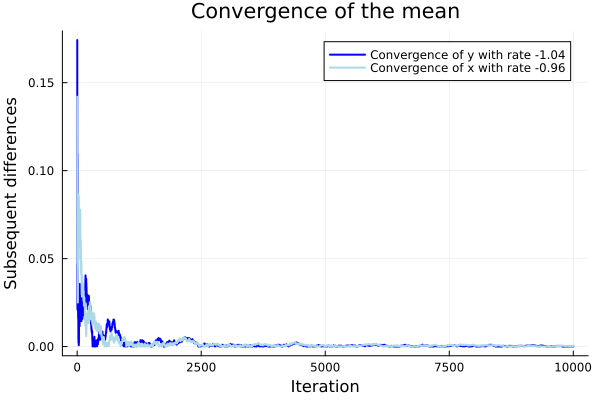

In [229]:
plot(2:10000,MCIntegration(samples0[2, :])[1],label="Convergence of y with rate -1.04",color="blue",lw=2)
plot!(2:10000,MCIntegration(samples0[1, :])[1],label="Convergence of x with rate -0.96", title="Convergence of the mean",
xlabel="Iteration",ylabel="Subsequent differences",color="lightblue",lw=2)
#savefig("4_MHRW_convergencemean.png")

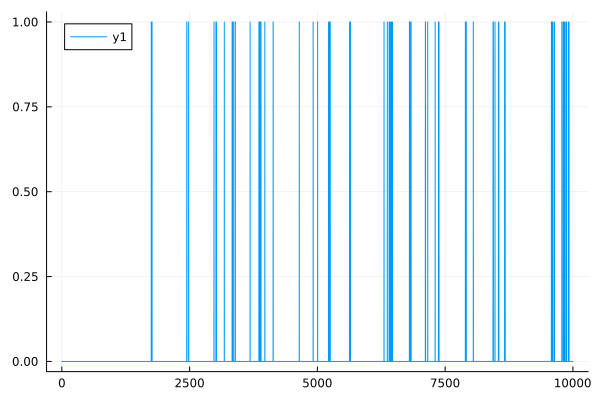

In [185]:
plot(MCIntegration(samples0[2, :]) .< 1E-5)

In [191]:
findfirst(x -> x == 1, MCIntegration(samples0[2, :]) .< 1E-6)

2446

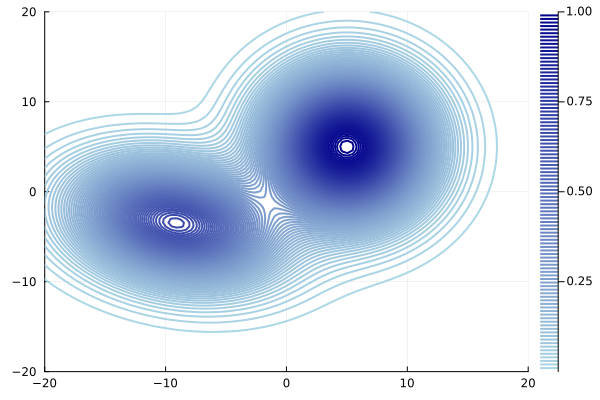

In [129]:
function energia1(p)
    x = p[1]
    y = p[2]
    a = 3*(x-5)^2+2*(y-5)^2
    b = 2*(x+10)^2+3*(y+5)^2 + x*y
    return exp(-a/100) + exp(-b/100)
end
ran = range(-20, 20, length=100)
contour1 = contour(ran, ran, [energia1((i, j)) for j in ran, i in ran], levels=100, linewidth=2, color=:blues)

In [146]:
samples1, probabilities1, Alpha1, MAP1, CM1 = MHRW(energia1,2,[0.0,-20.0],0.5,20000)

([0.0 0.39518407645602616 … -10.538104273284553 -11.88128227564147; -20.0 -20.373962855989234 … 3.3038290691393 3.7228457367259504], [0.00016022167142790744, 0.0001053196336592737, 0.00010732536806596535, 0.00010732536806596535, 0.00023003470768876612, 9.972118570411551e-5, 9.972118570411551e-5, 6.844819733857725e-5, 6.844819733857725e-5, 0.00016904825918362398  …  0.10044492694898621, 0.09089575951184622, 0.09574461689773302, 0.17299607163445918, 0.1611132043831672, 0.19010133049941585, 0.15318807891596956, 0.1786278883855289, 0.1786278883855289, 0.14810448681613406], [0.657337005167012, 1.0, 0.34345246033529014, 1.0, 0.43350495543062545, 0.41827965601113304, 0.6863957428431617, 0.6420950822484, 1.0, 1.0  …  1.0, 0.9049313118422615, 1.0, 1.0, 0.931311346326982, 1.0, 0.8058232865258156, 1.0, 0.6065898412051148, 0.8291229782467292], [4.982491450128894, 4.973159099653741], [-2.3624845174646283, -0.10156354682661804])

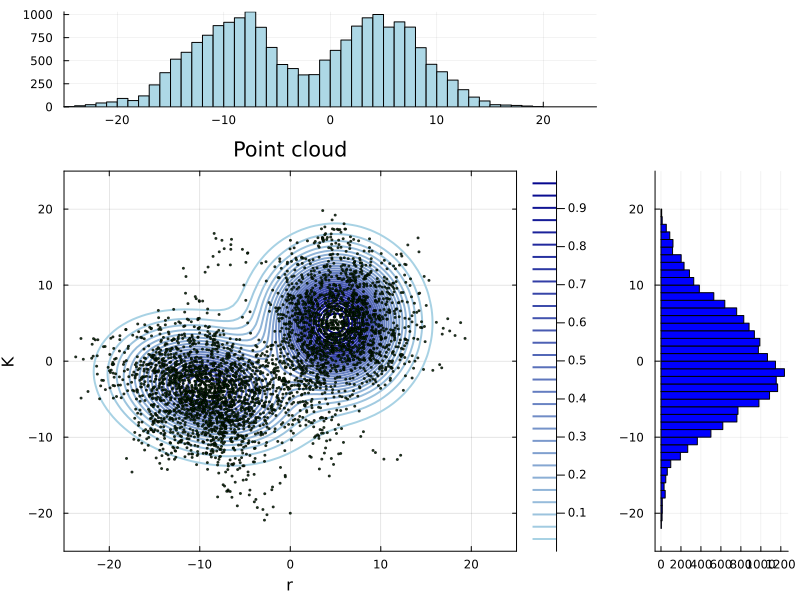

In [150]:
xhist = samples1[1, :]
yhist = samples1[2, :]
lim = 25
ran = range(-lim, lim, length=100)
sxy = contour(ran, ran, [energia1((i, j)) for j in ran, i in ran], levels=30, linewidth=2, color=:blues,xlim=(-lim,lim),ylim=(-lim,lim))
sxy = scatter!(xhist[1:5:end], yhist[1:5:end], markersize=1, title="Point cloud", color="green", alpha=0.8,
    xlabel="x", ylabel="y", border=:box,xlim=(-lim,lim),ylim=(-lim,lim))
hx = histogram(xhist,color="lightblue",xlim=(-lim,lim))
hy = histogram(yhist, orientation=:horizontal,ylim=(-lim,lim),color="blue")
p0 = Plots.Plot()
cuadricula = grid(2,2, heights=(0.2,0.8), widths=(0.8,0.2))
plot(hx, p0, sxy, hy, legend=:none, layout=cuadricula,size=(800,600))

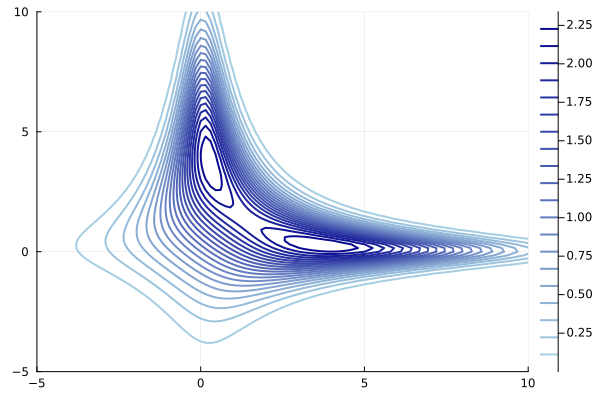

In [196]:
function energia2(p)
    x = p[1]
    y = p[2]
    a = (1/20)*((x*y)^2 + x^2 + y^2 - 8*x - 8*y)
    return exp(-a) 
end
ran = range(-5, 10, length=100)
contour2 = contour(ran, ran, [energia2((i, j)) for j in ran, i in ran], levels=20, linewidth=2, color=:blues)

## Usando MHRW

In [198]:
samples2, probabilities2, Alpha2, MAP2, CM2 = MHRW(energia2,2,[-10.0,-10.0],0.2,10000)

([-10.0 -10.0 … 2.613342853993261 2.619214553201739; -10.0 -10.0 … 0.6276853371088091 0.6148448235737926], [1.0850715436432725e-225, 1.0850715436432725e-225, 1.0850715436432725e-225, 1.6862782070881969e-214, 1.6862782070881969e-214, 7.355084939395144e-181, 7.355084939395144e-181, 7.1228538915422865e-162, 1.0251235308870095e-136, 1.4029727013521484e-121  …  1.8822062655114093, 1.8822062655114093, 2.006237900371412, 1.659859647562466, 1.8474340694989713, 1.9339538469229893, 2.2332359661654895, 2.2332359661654895, 2.227088742460215, 2.230078303554285], [2.7935679477631924e-11, 5.375776951357889e-15, 1.0, 8.38142361399944e-71, 1.0, 5.971961464067347e-10, 1.0, 1.0, 1.0, 1.0  …  0.8849169269201167, 0.6346163072016203, 1.0, 0.8273493623339377, 1.0, 1.0, 1.0, 0.8752886274918219, 0.9972473917676377, 1.0], [0.27600332794865645, 3.741851407493453], [1.4647962980011162, 2.149691636248108])

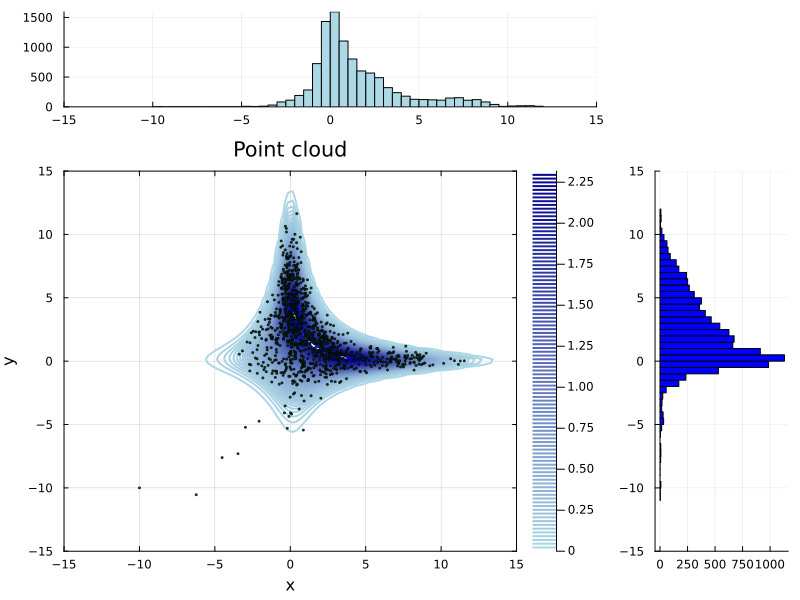

In [201]:
xhist = samples2[1, :]
yhist = samples2[2, :]
lim = 15
ran = range(-lim, lim, length=100)
sxy = contour(ran, ran, [energia2((i, j)) for j in ran, i in ran], levels=100, linewidth=2, color=:blues,xlim=(-lim,lim),ylim=(-lim,lim))
sxy = scatter!(xhist[1:10:end], yhist[1:10:end], markersize=1, title="Point cloud", color="green", alpha=0.8,
    xlabel="x", ylabel="y", border=:box,xlim=(-lim,lim),ylim=(-lim,lim))
hx = histogram(xhist,color="lightblue",xlim=(-lim,lim))
hy = histogram(yhist, orientation=:horizontal,ylim=(-lim,lim),color="blue")
p0 = Plots.Plot()
cuadricula = grid(2,2, heights=(0.2,0.8), widths=(0.8,0.2))
plot(hx, p0, sxy, hy, legend=:none, layout=cuadricula,size=(800,600))

## Usando Gibbs 

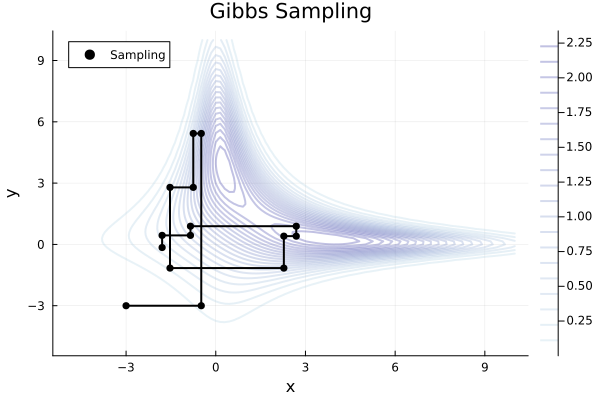

In [228]:
# Número de iteraciones
N = 5000

# Inicialización de las cadenas
x = zeros(N+1)
y = zeros(N+1)

# Condiciones iniciales
x[1] = -3.0
y[1] = -3.0

# Definir las funciones de media y desviación estándar
sig = (z, i) -> sqrt(10.0 / (1.0 + z[i]^2))
mu = (z, i) -> 4.0 / (1.0 + z[i]^2)

# Algoritmo de Gibbs sampling
for i in 2:2:N
    sig_x = sig(y, i-1)
    mu_x = mu(y, i-1)
    x[i] = rand(Normal(mu_x, sig_x))
    y[i] = y[i-1]

    sig_y = sig(x, i)
    mu_y = mu(x, i)
    y[i+1] = rand(Normal(mu_y, sig_y))
    x[i+1] = x[i]
end

contour(range(-5, 10, length=100), range(-5, 10, length=100), 
    [energia2((i, j)) for j in range(-5, 10, length=100), 
            i in range(-5, 10, length=100)], levels=20, linewidth=2, color=:blues,alpha=0.25,label="Contours")
plot!(x[1:15], y[1:15], lw=2, label="", xlabel="x", ylabel="y", title="Gibbs Sampling",color="black")
scatter!(x[1:15], y[1:15], lw=2, markersize=4,label="Sampling",color="black")

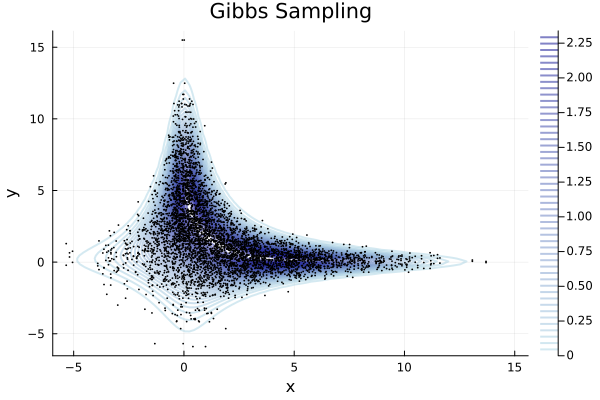

In [233]:
contour(range(-5, 15, length=100), range(-5, 15, length=100), 
    [energia2((i, j)) for j in range(-5, 15, length=100), 
            i in range(-5, 15, length=100)], levels=50, linewidth=2, color=:blues,alpha=0.5)
scatter!(x, y, markersize=1, label="", xlabel="x", ylabel="y", title="Gibbs Sampling",color="black")

## Usando bi-walk

In [ ]:
gre

In [539]:
function bi_walk(energia,np,p0,pp0,δ₀=1,iterations=10000)

    function bienergia(X₁,X₂)
        return sqrt(abs(energia(X₁)*energia(X₂)))
    end
    
    #Muestras del algorimo
    samples = zeros(2*np,iterations)
    #Punto de partida
    samples[1:np,1] = p0
    samples[np+1:2*np,1] = pp0

    
    
    #Probabilidades
    probabilities = zeros(iterations)
    probabilities[1] = bienergia(samples[1:np,1],samples[np+1:2*np,1])


    #Tasa de aceptación
    Alpha = zeros(iterations-1)
    
    # Algoritmo Metrópolis-Hastings
    for i in 1:iterations-1
        
        #Estado actual
        Xᵢ = samples[1:np,i]
        Xᵢ⁺ = samples[np+1:2*np,i]

        
        u = rand()
        δ = norm(Xᵢ⁺-Xᵢ) + δ₀
        
        if rand(Bernoulli(0.5))
            samples[1:np,i+1] = Xᵢ
            #Estado propuesto
            Xₚ =  rand(MvNormal(Xᵢ⁺,δ*I))
            #π(Estado actual → Estado propuesto)
            pfor = energia(Xₚ) * pdf(MvNormal(Xₚ,(norm(Xₚ-Xᵢ) + 1)*I),Xᵢ⁺)
            #π(Estado propuesto → Estado actual)
            pback = energia(Xᵢ⁺) * pdf(MvNormal(Xᵢ⁺,δ*I),Xₚ)
            #Tasa de aceptacion α
            alpha = min(1, pfor/pback)   
            Alpha[i] = alpha              
            if u < alpha 				#Aceptación
                samples[np+1:2*np,i+1] = Xₚ
                probabilities[i+1] = bienergia(Xᵢ,Xₚ)
            else 						#Rechazo
                samples[np+1:2*np,i+1] = Xᵢ⁺
                probabilities[i+1] = bienergia(Xᵢ,Xᵢ⁺)
            end
            
        else 
            samples[np+1:2*np,i+1] = Xᵢ⁺
            #Estado propuesto
            Xₚ =  rand(MvNormal(Xᵢ,δ*I))
            #π(Estado actual → Estado propuesto)
            pfor = energia(Xₚ) * pdf(MvNormal(Xₚ,(norm(Xₚ-Xᵢ⁺) + 1)*I),Xᵢ)
            #π(Estado propuesto → Estado actual)
            pback = energia(Xᵢ⁺) * pdf(MvNormal(Xᵢ,δ*I),Xₚ)
            #Tasa de aceptacion α
            alpha = min(1, pfor/pback)   
            Alpha[i] = alpha              
            if u < alpha 				#Aceptación
                samples[1:np,i+1] = Xₚ
                probabilities[i+1] = bienergia(Xₚ,Xᵢ⁺)
            else 						#Rechazo
                samples[1:np,i+1] = Xᵢ
                probabilities[i+1] = bienergia(Xᵢ,Xᵢ⁺)
            end
        end
    end
    return samples, probabilities, Alpha
end

bi_walk (generic function with 5 methods)

In [549]:
samples2b, probabilities2b, Alpha2b = bi_walk(energia2,2,[5.0,5.0],[4.0,-4.0],1,10000)
samples2b

4×10000 Matrix{Float64}:
  5.0   5.0   5.0   5.0       …   2.82184     2.82184     2.82184
  5.0   5.0   5.0   5.0           1.76124     1.76124     1.76124
  4.0   4.0   4.0  -0.573291     -1.0705     -1.0705     -1.0705
 -4.0  -4.0  -4.0  -3.37931      -0.0889719  -0.0889719  -0.0889719

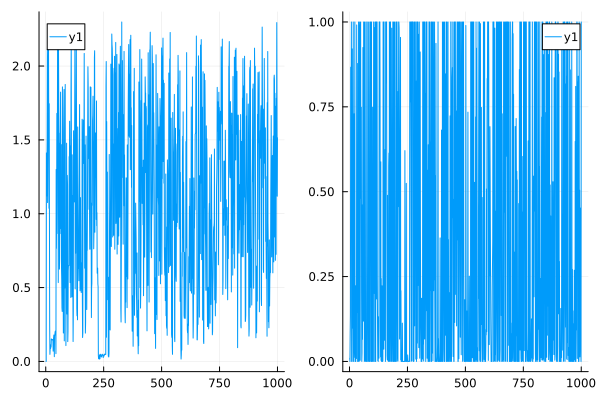

In [550]:
plot(plot(probabilities2b[1:10:end]),plot(Alpha2b[1:10:end]),layout=(1,2))


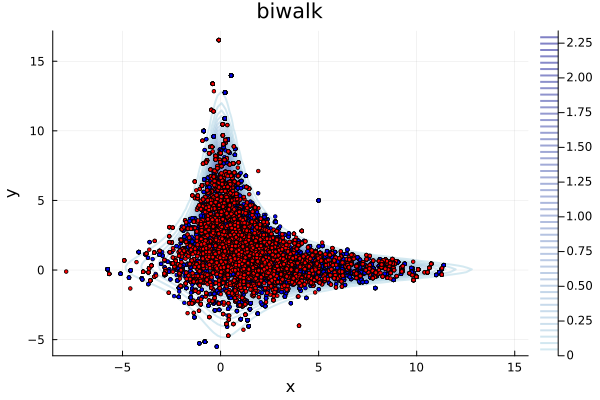

In [551]:
contour(range(-5, 15, length=100), range(-5, 15, length=100), 
    [energia2((i, j)) for j in range(-5, 15, length=100), 
            i in range(-5, 15, length=100)], levels=50, linewidth=2, color=:blues,alpha=0.5)
scatter!(samples2b[1,:], samples2b[2,:], markersize=2, label="", xlabel="x", ylabel="y", title="biwalk",color="blue")
scatter!(samples2b[3,:], samples2b[4,:], markersize=2, label="", color="red")